In [82]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import plotly.graph_objects as go
import scipy.stats as stats

# P3 - Open Food Facts

In [83]:
#Lecture du csv
data = pd.read_csv('fr.openfoodfacts.org.products.csv', sep='\t', low_memory=False)

## Description des données

In [84]:
row, col = data.shape
print(f'OpenFoodFacts contient {row} lignes et {col} colonnes.')

OpenFoodFacts contient 320772 lignes et 162 colonnes.


In [85]:
data.describe(exclude=[np.number])

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,...,nutrition_grade_fr,pnns_groups_1,pnns_groups_2,states,states_tags,states_fr,main_category,main_category_fr,image_url,image_small_url
count,320749,320749,320770,320769,320763,320772,320772,303010,52795,104819,...,221210,91513,94491,320726,320726,320726,84366,84366,75836,75836
unique,320749,320749,3535,189567,189568,180495,180495,221347,38584,13826,...,5,14,42,1021,1021,1021,3543,3543,75836,75836
top,0000000003087,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489077120,2017-03-09T10:37:09Z,1439141742,2015-08-09T17:35:42Z,Ice Cream,Pâtes alimentaires au blé dur de qualité supér...,500 g,...,d,unknown,unknown,"en:to-be-completed, en:nutrition-facts-complet...","en:to-be-completed,en:nutrition-facts-complete...","A compléter,Informations nutritionnelles compl...",en:beverages,Boissons,http://fr.openfoodfacts.org/images/products/00...,http://fr.openfoodfacts.org/images/products/00...
freq,1,1,169868,20,20,33,33,410,201,4669,...,62763,22624,22624,168905,168905,168905,6054,6054,1,1


In [86]:
data.describe()

,no_nutriments,additives_n,ingredients_from_palm_oil_n,ingredients_from_palm_oil,ingredients_that_may_be_from_palm_oil_n,ingredients_that_may_be_from_palm_oil,nutrition_grade_uk,energy_100g,energy-from-fat_100g,fat_100g,...,ph_100g,fruits-vegetables-nuts_100g,collagen-meat-protein-ratio_100g,cocoa_100g,chlorophyl_100g,carbon-footprint_100g,nutrition-score-fr_100g,nutrition-score-uk_100g,glycemic-index_100g,water-hardness_100g
count,0.0,248939.000000,248939.000000,0.0,248939.000000,0.0,0.0,2.611130e+05,857.000000,243891.000000,...,49.000000,3036.000000,165.000000,948.000000,0.0,268.000000,221210.000000,221210.000000,0.0,0.0
mean,NaN,1.936024,0.019659,NaN,0.055246,NaN,NaN,1.141915e+03,585.501214,12.730379,...,6.425698,31.458587,15.412121,49.547785,NaN,341.700764,9.165535,9.058049,NaN,NaN
std,NaN,2.502019,0.140524,NaN,0.269207,NaN,NaN,6.447154e+03,712.809943,17.578747,...,2.047841,31.967918,3.753028,18.757932,NaN,425.211439,9.055903,9.183589,NaN,NaN
min,NaN,0.000000,0.000000,NaN,0.000000,NaN,NaN,0.000000e+00,0.000000,0.000000,...,0.000000,0.000000,8.000000,6.000000,NaN,0.000000,-15.000000,-15.000000,NaN,NaN
25%,NaN,0.000000,0.000000,NaN,0.000000,NaN,NaN,3.770000e+02,49.400000,0.000000,...,6.300000,0.000000,12.000000,32.000000,NaN,98.750000,1.000000,1.000000,NaN,NaN
50%,NaN,1.000000,0.000000,NaN,0.000000,NaN,NaN,1.100000e+03,300.000000,5.000000,...,7.200000,23.000000,15.000000,50.000000,NaN,195.750000,10.000000,9.000000,NaN,NaN
75%,NaN,3.000000,0.000000,NaN,0.000000,NaN,NaN,1.674000e+03,898.000000,20.000000,...,7.400000,51.000000,15.000000,64.250000,NaN,383.200000,16.000000,16.000000,NaN,NaN
max,NaN,31.000000,2.000000,NaN,6.000000,NaN,NaN,3.251373e+06,3830.000000,714.290000,...,8.400000,100.000000,25.000000,100.000000,NaN,2842.000000,40.000000,40.000000,NaN,NaN


<Axes: >

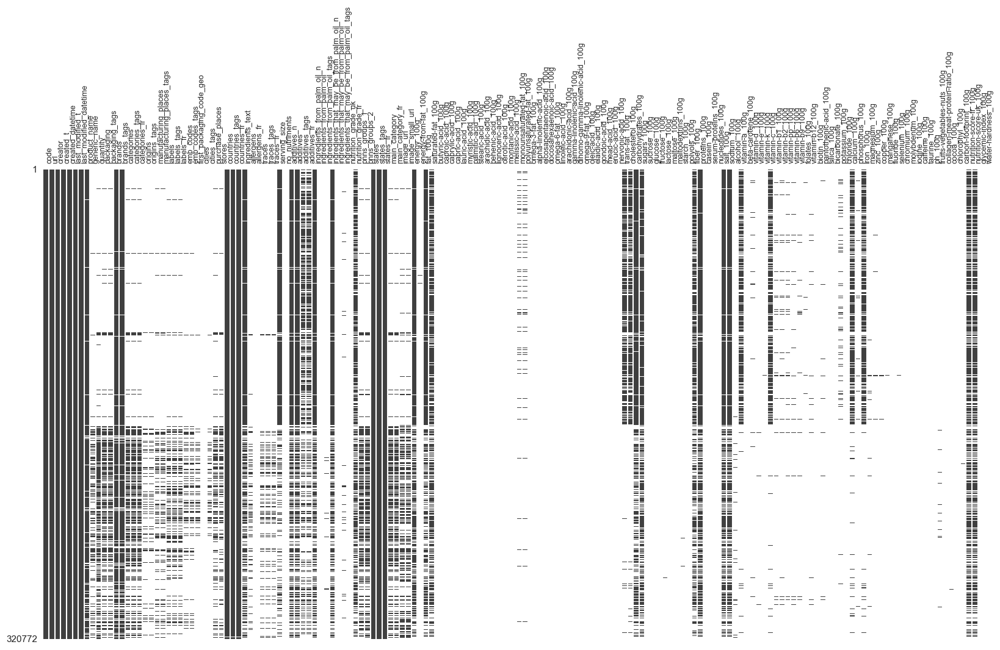

In [87]:
msno.matrix(data, sparkline=False,figsize=(20, 10),fontsize=9, labels=all(data), label_rotation=90)

<Axes: >

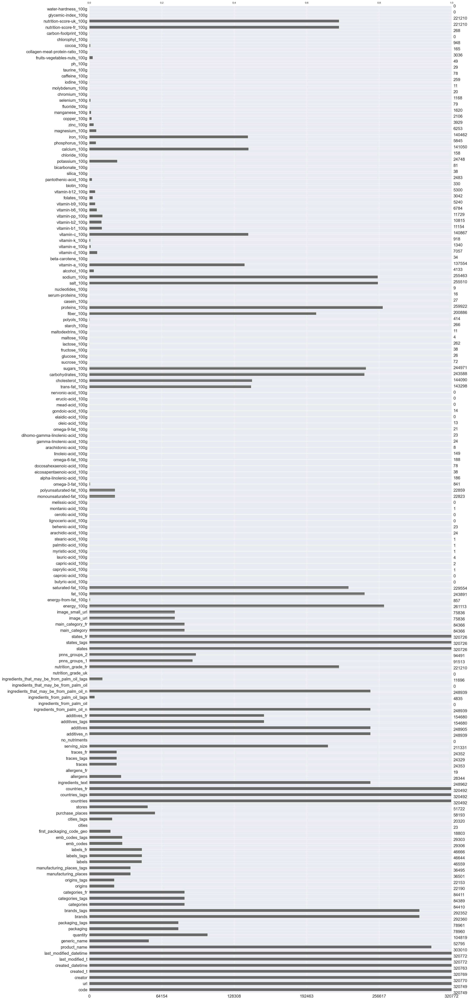

In [88]:
msno.bar(data)

In [89]:
data.isna().mean().mean()

0.7622157263195134

In [90]:
data.head(20)

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,...,ph_100g,fruits-vegetables-nuts_100g,collagen-meat-protein-ratio_100g,cocoa_100g,chlorophyl_100g,carbon-footprint_100g,nutrition-score-fr_100g,nutrition-score-uk_100g,glycemic-index_100g,water-hardness_100g
0,0000000003087,http://world-fr.openfoodfacts.org/produit/0000...,openfoodfacts-contributors,1474103866,2016-09-17T09:17:46Z,1474103893,2016-09-17T09:18:13Z,Farine de blé noir,NaN,1kg,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0000000004530,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489069957,2017-03-09T14:32:37Z,1489069957,2017-03-09T14:32:37Z,Banana Chips Sweetened (Whole),NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,14.0,14.0,NaN,NaN
2,0000000004559,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489069957,2017-03-09T14:32:37Z,1489069957,2017-03-09T14:32:37Z,Peanuts,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN
3,0000000016087,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489055731,2017-03-09T10:35:31Z,1489055731,2017-03-09T10:35:31Z,Organic Salted Nut Mix,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,12.0,12.0,NaN,NaN
4,0000000016094,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489055653,2017-03-09T10:34:13Z,1489055653,2017-03-09T10:34:13Z,Organic Polenta,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,0000000016100,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489055651,2017-03-09T10:34:11Z,1489055651,2017-03-09T10:34:11Z,Breadshop Honey Gone Nuts Granola,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,0000000016117,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489055730,2017-03-09T10:35:30Z,1489055730,2017-03-09T10:35:30Z,Organic Long Grain White Rice,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,0000000016124,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489055711,2017-03-09T10:35:11Z,1489055712,2017-03-09T10:35:12Z,Organic Muesli,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,7.0,7.0,NaN,NaN
8,0000000016193,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489055651,2017-03-09T10:34:11Z,1489055651,2017-03-09T10:34:11Z,Organic Dark Chocolate Minis,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,0000000016513,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489055654,2017-03-09T10:34:14Z,1489055654,2017-03-09T10:34:14Z,Organic Sunflower Oil,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Nettoyage des données

On supprime les colonnes où plus de 80% des données sont vides

In [91]:
data.drop(data.columns[data.isnull().mean()>0.8], axis=1, inplace=True)

<Axes: >

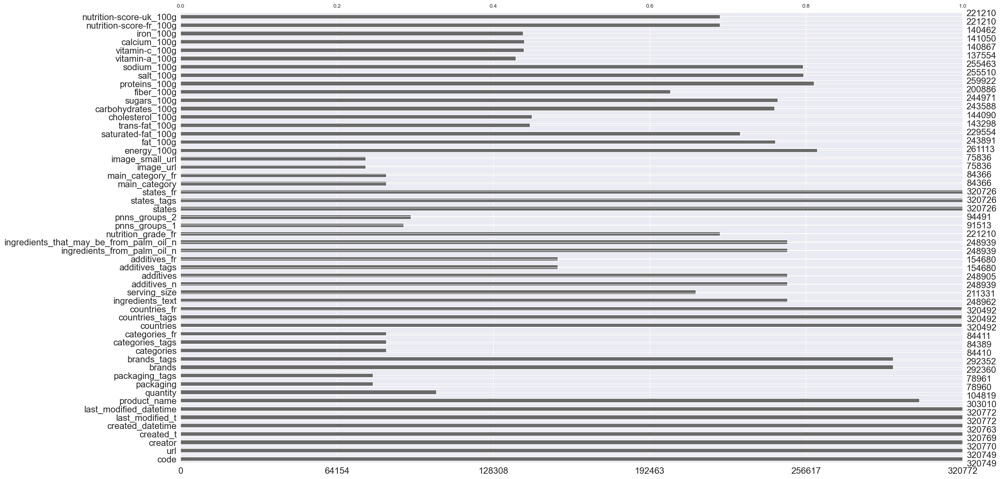

In [92]:
msno.bar(data)

In [93]:
row, col = data.shape
print(f'OpenFoodFacts contient {row} lignes et {col} colonnes.')

OpenFoodFacts contient 320772 lignes et 54 colonnes.


## Exploration

In [94]:
# On récupère seulement les lignes dont la colonne pnns_group_2 est remplie
pnns2 = data[~data['pnns_groups_2'].isna()]

<Axes: >

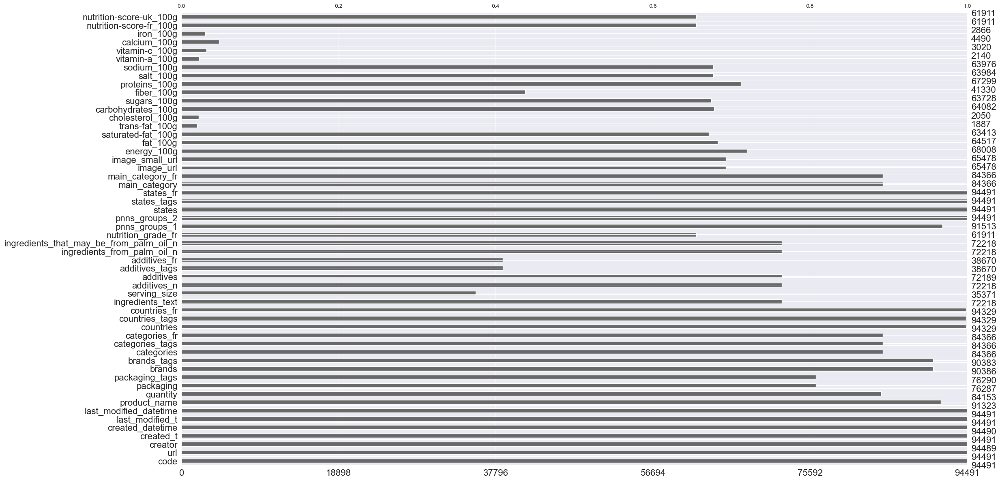

In [95]:
msno.bar(pnns2)

In [96]:
pnns2.isna().mean().mean()

0.27255447020821505

In [97]:
# On supprime les colonnes dont plus de 50% des données sont vides
pnns2.drop(pnns2.columns[pnns2.isnull().mean()>0.5], axis=1, inplace=True)

C:\Users\adrie\AppData\Local\Temp\ipykernel_22892\1241322802.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<Axes: >

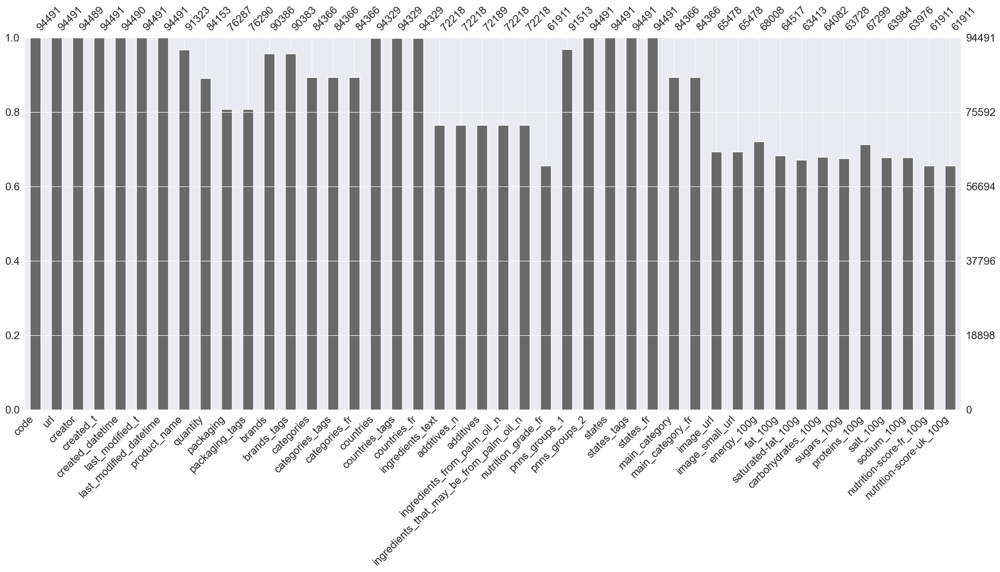

In [98]:
msno.bar(pnns2)

In [99]:
pnns2.isna().mean().mean()

0.14823369421426377

Suppression des colonnes qui ne nous intéresserait pas 
Date de création/modification qui existe plusieurs fois

In [100]:
pnns2 = pnns2.drop(columns=['url','creator','created_t','created_datetime','last_modified_t','last_modified_datetime','quantity','packaging','packaging_tags','brands','brands_tags','categories','categories_tags','categories_fr','countries','countries_tags','countries_fr','additives','additives_n','states','states_fr','states_tags','main_category','image_url','image_small_url','nutrition-score-uk_100g'], axis=1)

<Axes: >

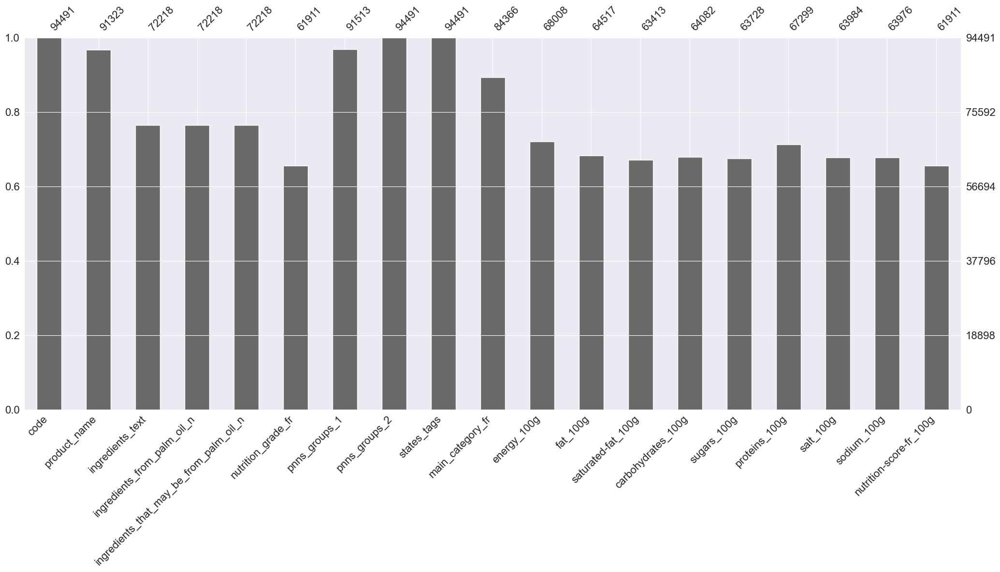

In [101]:
msno.bar(pnns2)

<Axes: >

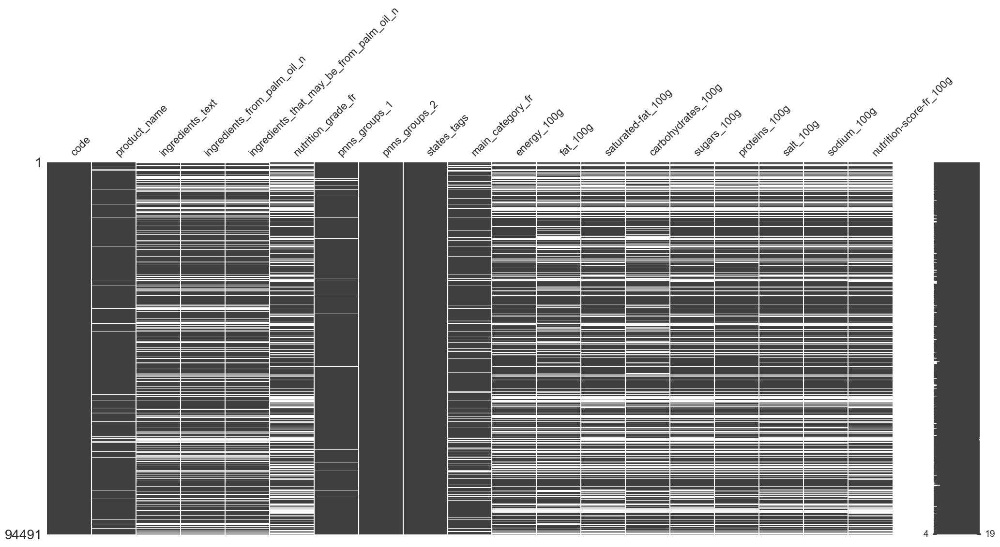

In [102]:
msno.matrix(pnns2)

<Axes: >

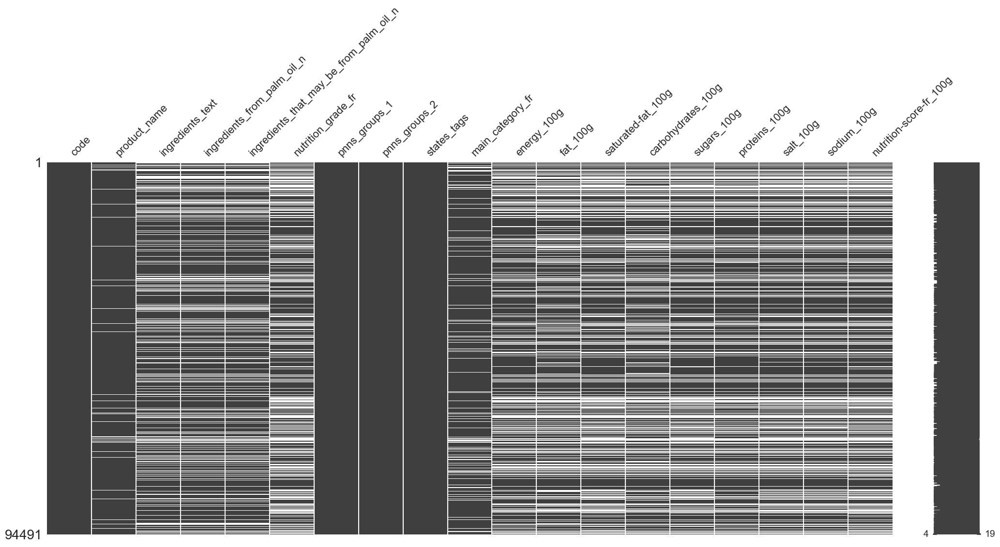

In [103]:
# Corrige les fautes de syntax
pnns2.replace('vegetables','Vegetables',inplace=True)
pnns2.replace('legumes','Vegetables',inplace=True)
pnns2.replace('Legumes','Vegetables',inplace=True)
pnns2.replace('fruits','Fruits',inplace=True)
pnns2.replace('cereals','Cereals',inplace=True)
pnns2.replace('nuts','Nuts',inplace=True)

# Remplir les valeurs manquantes dans 'group' en fonction des valeurs de 'subgroup'
# On suppose qu'il y a une correspondance unique entre 'pnns_groups_2' et 'pnns_groups_1'
pnns2_to_pnns1 = pnns2.groupby('pnns_groups_2')['pnns_groups_1'].agg(lambda x: x.dropna().unique()[0] if len(x.dropna().unique()) > 0 else 'unknown')

# Imputer les valeurs manquantes dans 'pnns_groups_1'
pnns2['pnns_groups_1'] = pnns2.apply(lambda row: pnns2_to_pnns1[row['pnns_groups_2']] if pd.isnull(row['pnns_groups_1']) else row['pnns_groups_1'], axis=1)

msno.matrix(pnns2)

C:\Users\adrie\anaconda3\envs\OpenFoodFact\lib\site-packages\seaborn\axisgrid.py:123: UserWarning:

The figure layout has changed to tight



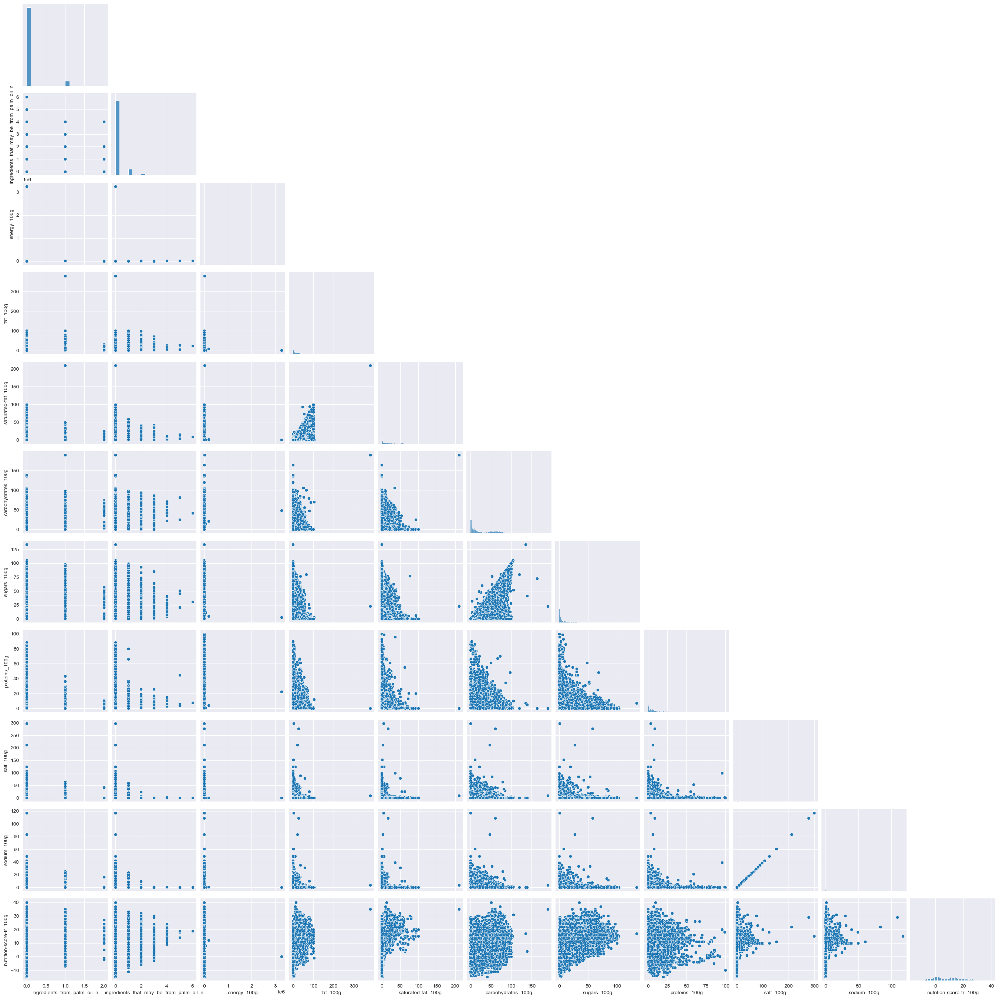

In [104]:
sns.pairplot(pnns2, corner=True)

In [105]:
# Retire les inconnus dans les groups
pnns2 = pnns2[pnns2['pnns_groups_2'] != 'unknown']
#Des données d'énergie dépassent l'apport calorique maximum, qui est de 900,00 kcal
pnns2 = pnns2.loc[pnns2['energy_100g'] < 900]
#Sélectionne les colonnes avec des entiers
data_float = pnns2.select_dtypes(include='float64')
#On retire les colonnes qui font trop de bruits ou qui serait doublons (salt_100g pour sodium_100g)
data_float = data_float.drop(['ingredients_from_palm_oil_n','ingredients_that_may_be_from_palm_oil_n','salt_100g'],axis=1)

In [116]:
pnns2

,code,product_name,ingredients_text,ingredients_from_palm_oil_n,ingredients_that_may_be_from_palm_oil_n,nutrition_grade_fr,pnns_groups_1,pnns_groups_2,states_tags,main_category_fr,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,sodium_100g,nutrition-score-fr_100g
185,0000008237798,Quiche Lorraine,INGRÉDIENTS : GARNITURE (SUBSTANCES LAITIÈRES....,0.0,0.0,b,Composite foods,Pizza pies and quiche,"en:to-be-checked,en:complete,en:nutrition-fact...",Plats préparés,478.0,6.79,2.86,7.86,0.714,5.36,0.49900,0.196000,2.0
186,0000008240095,Pâté au poulet,NaN,NaN,NaN,NaN,Fish Meat Eggs,Meat,"en:to-be-completed,en:nutrition-facts-complete...",Volailles,751.0,10.20,NaN,16.60,NaN,33.90,0.73500,0.289000,NaN
226,0000040608754,"Pepsi, Nouveau goût !","Eau gazéifiée, sucre, colorant caramel E150d, ...",0.0,0.0,e,Beverages,Sweetened beverages,"en:to-be-checked,en:complete,en:nutrition-fact...",Sodas,177.0,0.00,0.00,10.40,10.400,0.00,0.02540,0.010000,13.0
236,00000758,Cauliflower,Cauliflower,0.0,0.0,NaN,Fruits and vegetables,Vegetables,"en:to-be-checked,en:complete,en:nutrition-fact...",Légumes frais,144.0,0.90,NaN,2.90,2.500,3.60,0.00000,0.000000,NaN
239,0000084154071,Salsa de mostaza,"Agua, vinagre, _mostaza_, azúcares, sal, espec...",0.0,0.0,NaN,Fat and sauces,Dressings and sauces,"en:to-be-checked,en:complete,en:nutrition-fact...",Condiments,320.0,3.50,NaN,7.50,NaN,3.60,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
320630,9556156046726,Sauce pimentée à l'ail,"Eau, piment (21%), ail (21%), sucre, sel, acid...",0.0,0.0,NaN,Fat and sauces,Dressings and sauces,"en:to-be-checked,en:complete,en:nutrition-fact...",Epicerie,247.0,0.00,NaN,17.65,17.650,0.00,2.83972,1.118000,NaN
320668,9577283844672,100% Pur Jus 4 agrumes,"Jus d'orange (dont pulpe 1,6%), jus de clément...",0.0,0.0,c,Beverages,Fruit juices,"en:to-be-checked,en:complete,en:nutrition-fact...",Jus de fruits,192.0,0.50,0.00,10.20,9.200,0.60,0.03000,0.011811,4.0
320683,96069868,tuna chunks in spring water,"Tuna, spring water",0.0,0.0,a,Fish Meat Eggs,Fish and seafood,"en:to-be-checked,en:complete,en:nutrition-fact...",Thons,444.0,0.50,0.00,0.00,0.000,25.00,0.76200,0.300000,-1.0
320693,96092521,Santa Cruz Chilli & Lime Dressing,"Water, Sugar, Rice Wine Vinegar (contains Sulp...",0.0,0.0,c,Fat and sauces,Dressings and sauces,"en:to-be-checked,en:complete,en:nutrition-fact...",Epicerie,660.0,6.90,0.50,23.10,16.700,0.30,0.54102,0.213000,6.0


In [106]:
fig = go.Figure()

fig.add_trace(go.Box(y=data_float['energy_100g'].values, name=data_float['energy_100g'].name, boxpoints='all'))

fig.show()

In [107]:
data_float_without_energy = data_float.drop(['energy_100g'], axis=1)
fig = go.Figure()
for col in data_float_without_energy:
    fig.add_trace(go.Box(y=data_float_without_energy[col].values, name=data_float_without_energy[col].name,boxpoints="all"))
fig.show()

In [108]:
fig = go.Figure()
fig.add_trace(go.Box(y=pnns2['carbohydrates_100g'].values,x=pnns2['pnns_groups_2'],boxpoints="all"))
fig.show()

In [110]:
fig = go.Figure()
fig.add_trace(go.Box(y=pnns2['saturated-fat_100g'].values,x=pnns2['pnns_groups_2'],boxpoints="all"))
fig.show()

In [111]:
fig = go.Figure()
fig.add_trace(go.Box(y=pnns2['fat_100g'].values,x=pnns2['pnns_groups_2'],boxpoints="all"))
fig.show()

In [112]:
fig = go.Figure()
fig.add_trace(go.Box(y=pnns2['sugars_100g'].values,x=pnns2['pnns_groups_2'],boxpoints="all"))
fig.show()

In [113]:
fig = go.Figure()
fig.add_trace(go.Box(y=pnns2['proteins_100g'].values,x=pnns2['pnns_groups_2'],boxpoints="all"))
fig.show()

In [114]:
fig = go.Figure()
fig.add_trace(go.Box(y=pnns2['sodium_100g'].values,x=pnns2['pnns_groups_2'],boxpoints="all"))
fig.show()

In [115]:
fig = go.Figure()
fig.add_trace(go.Box(y=pnns2['nutrition-score-fr_100g'].values,x=pnns2['pnns_groups_2'],boxpoints="all"))
fig.show()

In [109]:
stats.ks(pnns2['carbohydrates_100g'])

AttributeError: module 'scipy.stats' has no attribute 'ks'

In [ ]:
sns.scatterplot(pnns2, x='saturated-fat_100g', y='pnns_groups_2')

In [ ]:
sns.scatterplot(pnns2, x='fat_100g', y='pnns_groups_2')

In [ ]:
sns.scatterplot(pnns2, x='sugars_100g', y='pnns_groups_2')

In [ ]:
sns.scatterplot(pnns2, x='proteins_100g', y='pnns_groups_2')

In [ ]:
sns.scatterplot(pnns2, x='sodium_100g', y='pnns_groups_2')

In [ ]:
sns.scatterplot(pnns2, x='nutrition-score-fr_100g', y='pnns_groups_2')

On réduit le nombre de groupes, en les rassemblant dans des catégories plus générales

In [ ]:
pnns2.replace('Dairy desserts','Milk',inplace=True)
pnns2.replace('Ice cream','Milk',inplace=True)
pnns2.replace('Milk and yogurt','Milk',inplace=True)
pnns2.replace('Breakfast cereals','Cereals',inplace=True)
pnns2.replace('Bread','Cereals',inplace=True)
pnns2.replace('Fruit juices','Fruits',inplace=True)
pnns2.replace('Fruit nectars','Fruits',inplace=True)
pnns2.replace('Processed meat','Proteins',inplace=True)
pnns2.replace('Meat','Proteins',inplace=True)
pnns2.replace('Fish and seafood','Proteins',inplace=True)
pnns2.replace('Eggs','Proteins',inplace=True)
pnns2.replace('Cheese','Proteins',inplace=True)
pnns2.replace('One-dish meals','Meals',inplace=True)
pnns2.replace('Pizza pies and quiche','Meals',inplace=True)
pnns2.replace('Sandwich','Meals',inplace=True)
pnns2.replace('Soups','Vegetables',inplace=True)
pnns2.replace('Chocolate products','Sweets',inplace=True)
pnns2.replace('Dried fruits','Sweets',inplace=True)
pnns2.replace('Nuts','Others',inplace=True)
pnns2.replace('pastries','Others',inplace=True)
pnns2.replace('Fats','Others',inplace=True)
pnns2.replace('Appetizers','Others',inplace=True)
pnns2.replace('Biscuits and cakes','Others',inplace=True)
pnns2.replace('Potatoes','Others',inplace=True)


In [ ]:
pnns2['pnns_groups_2'].value_counts()

In [ ]:
stats.f_oneway(pnns2['nutrition-score-fr_100g'][pnns2['pnns_groups_2'] == 'Meals'],
               pnns2['nutrition-score-fr_100g'][pnns2['pnns_groups_2'] == 'Proteins'])

In [ ]:
from sklearn.manifold import TSNE

print('Instantiation...')
tsne = TSNE(perplexity=5,metric='euclidean', init='pca')

# fit transform les données
print('Fit_Transforme les données...')
x_tsne = tsne.fit_transform(data_tsne)


In [ ]:
from matplotlib.pyplot import scatter
from sklearn.preprocessing import LabelEncoder

# encode les noms de groupes pour les associer à une couleur
le = LabelEncoder()
le.fit(pnns2['pnns_groups_2'])
encoder = le.transform(pnns2['pnns_groups_2'])
encoder.reshape(20328,1)

# taille du graphique
taille = 15

fig, ax = plt.subplots(1, 1, figsize=(taille, taille))

print('Scatter')
sns.scatterplot(x=tsne.embedding_[:,0],y=tsne.embedding_[:,1], hue=pnns2['pnns_groups_2'], palette='tab20',hue_order=le.classes_,)
ax.set_title('T-SNE (Target/Cluster)')
sns.set_theme(style='dark')

plt.show()

In [ ]:
data_tsne